<a href="https://colab.research.google.com/github/DongDong-Zoez/pytorchAI/blob/main/GAN/SRGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Train [SRGAN](https://arxiv.org/abs/1609.04802) from scratch

![](https://production-media.paperswithcode.com/methods/Screen_Shot_2020-07-19_at_11.13.45_AM_zsF2pa7.png)

SRGAN 的任務是還原影像解析度

在 Generator 上，我們會輸入 LR (Low Resolution) 影像，在輸出 SR (Super Resolution) 影像

在 Discriminator 上

- 我們會輸入 HR (high Resolution) 影像，Discriminator 必須有辦法認出這是一張真實的高解析影像
- 同時，我們也會輸入 SR (Super Resolution) 影像，Discriminator 必須有辦法認出這是一張生成的影像



In [ ]:
# connect to your google drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
from torch import nn
import torch
from torchsummary import summary

class ResUnit(nn.Module):
    
    def __init__(self, in_channel=64, out_channels=64, kernel_size=3, stride=1, padding=1):
        super(ResUnit, self).__init__()
        
        self.conv1x1 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=1, stride=1, padding=0)
        self.conv3x3 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.activation = nn.PReLU()
        
    def forward(self, x):
            
        identity = x
        x = self.conv1x1(x)
        x = self.activation(x)
            
        x = self.conv3x3(x)
        x = self.activation(x)
            
        x = self.conv1x1(x)
            
        x = identity + x
        x = self.activation(x)
            
        return x

class generator(nn.Module):
    
    def __init__(self, kernel_size=3, stride=1, padding=1, num_ResUnit=5):
        super(generator, self).__init__()
        
        in_channels = 3
        out_channels= 64
        
        self.burn_in = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=9, stride=1, padding=4),
            nn.PReLU()
        )
        
        self.ResBlock = nn.Sequential()
        for i in range(num_ResUnit):
            self.ResBlock.add_module(f"ResUnit{i+1}", ResUnit(out_channels, out_channels, 3, 1, 1))
            
        self.Transition = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(out_channels)
        )
        
        self.CPP = nn.Sequential(
            nn.Conv2d(out_channels, out_channels*4, kernel_size, stride, padding=1),
            nn.PixelShuffle(2),
            nn.PReLU(),
            nn.Conv2d(out_channels, out_channels*4, kernel_size, stride, padding=1),
            nn.PixelShuffle(2),
            nn.PReLU()
        )
        
        self.output = nn.Conv2d(out_channels, out_channels=3, kernel_size=9, stride=1, padding=4)
            
        
    def forward(self, x):
        
        x = self.burn_in(x)
        identity = x
        x = self.ResBlock(x)
        x = self.Transition(x)

        x = x + identity
        x = self.CPP(x)
        x = self.output(x)
        
        return x

class CBL(nn.Module):
    
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1):
        super(CBL, self).__init__()
        
        self.cbl = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU()
        )
        
    def forward(self, x):
        
        x = self.cbl(x)
        
        return x


class discriminator(nn.Module):
    
    def __init__(self, num_CBL=7, num_classes=1):
        super(discriminator, self).__init__()
        
        in_channels = 3
        out_channels= [64,64,128,128,256,256,512,512]
        stride = [1,2,1,2,1,2,1,2]
        
        self.burn_in = nn.Sequential(
            nn.Conv2d(in_channels, out_channels[0], kernel_size=3, stride=stride[0], padding=1),
            nn.LeakyReLU()
        )
        
        self.CBL = nn.Sequential()
        for i in range(num_CBL):
            self.CBL.add_module(f"CBL{i+1}", CBL(out_channels[i], out_channels[i+1], stride=stride[i+1]))
        
        #self.CBL1 = CBL(out_channels[0], out_channels[1], stride=1)
        #self.CBL2 = CBL(out_channels[1], out_channels[2], stride=2)
        #self.CBL3 = CBL(out_channels[2], out_channels[3], stride=1)
        #self.CBL4 = CBL(out_channels[3], out_channels[4], stride=2)
        #self.CBL5 = CBL(out_channels[4], out_channels[5], stride=1)
        #self.CBL6 = CBL(out_channels[5], out_channels[6], stride=2)
        #self.CBL7 = CBL(out_channels[6], out_channels[7], stride=1)
        
        self.classifier = nn.Sequential(
            nn.Linear(out_channels[num_CBL]*8*8,1024),
            nn.LeakyReLU(),
            nn.Linear(1024, num_classes),
            nn.Sigmoid()
        )
        
        self.classifier = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(out_channels[num_CBL], 1024, kernel_size=3, stride=1, padding=1),
            nn.LeakyReLU(),
            nn.Conv2d(1024, 1, kernel_size=1, stride=1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        
        x = self.burn_in(x)
        x = self.CBL(x)
        
        #x = x.view(x.size(0),-1)
        x = self.classifier(x)     
        
        return x

#Build the Dataset

Noet: We use the data from [Kaggle Anime Face](https://www.kaggle.com/soumikrakshit/anime-faces)

In [ ]:
import torch
import cv2
import os
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import numpy as np

transform = [transforms.Compose([
    transforms.ToTensor(),
    #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    transforms.Resize([64,64])               
]),
  transforms.Compose([
      transforms.ToTensor(),
      #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
      transforms.Resize([256,256])               
  ])
]

class AnimeFacesDataset(Dataset):

    def __init__(self, transforms=transform ,path='/content/gdrive/MyDrive/AnimeFace2/train100/'):
        self.path = path
        self.transforms = transforms
        for root, dirs, files in os.walk(self.path):
            self.imgs = [self.path + file for file in files]

    def __getitem__(self, idx):
        img = cv2.imread(self.imgs[idx])
        lr = self.transforms[0](img)
        hr = self.transforms[1](img)

        return lr, hr

    def __len__(self):
        return len(self.imgs)

    def show_img(self, idx):

        img = cv2.imread(self.imgs[idx])
        lr = self.transforms[0](img)
        hr = self.transforms[1](img)

        lr = np.transpose(lr, [0,2,1])
        lr = np.array(lr)[::-1,...]

        hr = np.transpose(hr, [0,2,1])
        hr = np.array(hr)[::-1,...]

        plt.subplot(1,2,2)
        plt.title('LR')
        plt.axis('off')
        plt.imshow(lr.T, cmap='Greys_r')
        plt.subplot(1,2,1)
        plt.title('HR')
        plt.axis('off')
        plt.imshow(hr.T)


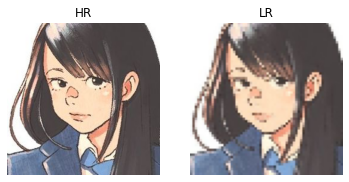

In [ ]:
anime = AnimeFacesDataset()

idx = 5
anime.show_img(idx)

# Loss Function



Loss function 分成兩個部分，Discriminator 使用的是一般的 ```BCELoss```

Generator 的 Loss function 比較複雜:

一般在訓練解析還原的模型，我們使用的損失函數大部分都是 MSE Loss，但是作者說這樣做通常會造成模型的細節模糊

所以作者提出了一個新的方法，將 HR 和 SR 送入 CNN 架構中提取特徵 (論文使用 VGG)，但也不是用整個 VGG 架構，因為我們要提取的是 feature map，提取完特徵之後，再進行一般的 MSE Loss 運算

可以想像比起直接用 HR 和 SR 做 MSE Loss，若是經過特徵提取後的 feature map 比較能抓出影像的高頻位置 (細節)

In [ ]:
import torch.nn as nn
import torch
from torchvision.models.vgg import vgg16


class ContentLoss(nn.Module):
    def __init__(self):
        super(ContentLoss, self).__init__()
        vgg = vgg16(pretrained=True)
        loss_network = nn.Sequential(*list(vgg.features)[:31]).eval()
        for param in loss_network.parameters():
            param.requires_grad = False
        self.loss_network = loss_network
        self.mse_loss = nn.MSELoss()

    def forward(self, fake_img_hr, target_img_hr):
        # Perception Loss
        perception_loss = self.mse_loss(self.loss_network(fake_img_hr), self.loss_network(target_img_hr))
        # img MSE Loss
        image_mse_loss = self.mse_loss(fake_img_hr, target_img_hr)
        return image_mse_loss + 0.006 * perception_loss


class AdversarialLoss(nn.Module):
    def __init__(self):
        super(AdversarialLoss, self).__init__()
        self.bec_loss = nn.BCELoss()

    def forward(self, logits_fake):
        # Adversarial Loss
        adversarial_loss = self.bec_loss(logits_fake.detach(), torch.ones_like(logits_fake))
        return 0.001 * adversarial_loss

在訓練過程中，Discriminator 有兩個目標

1. 輸入 HR，Label 應為 1 (此例中有做 Label smoothing)
  - 我們將真實影像以及 $1$ 放入 Loss function 計算梯度
2. 輸入 SR，Label 應為 0 (此例中有做 Label smoothing)
  - 我們將生成影像以及 $0$ 放入 Loss function 計算梯度

Generator 的任務只有把 LR 生成出的影像放入 Discrimator 之後盡量得到 $1$

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import transforms
import torch.optim as optim
import os


batchsize = 1
epochs = 100
learning_rate = 0.0001
train_data_path = '/content/gdrive/MyDrive/AnimeFace/data'
checkpoint_path = 'checkpoints'

transform = transforms.Compose([transforms.ToTensor(),
                                transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])
traindata = AnimeFacesDataset()
traindata_loader = DataLoader(traindata, batch_size=batchsize, shuffle=True)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
netG = generator().to(device)
netD = discriminator().to(device)
optimizerG = optim.Adam(netG.parameters(), lr=learning_rate)
optimizerD = optim.Adam(netD.parameters(), lr=learning_rate)
bce = nn.BCELoss()
contentLoss = ContentLoss().to(device)
adversarialLoss = AdversarialLoss()

if not os.path.exists(checkpoint_path):
    os.mkdir(checkpoint_path)

torch.save(netG, checkpoint_path+'/netG-epoch_000.pth')
for epoch in range(1, epochs+1):
    for idx, (lr, hr) in enumerate(traindata_loader):
        lr = lr.to(device)
        hr = hr.to(device)

        # 更新判别器
        netD.zero_grad()
        logits_fake = netD(netG(lr).detach())
        logits_real = netD(hr)
        # Lable smoothing
        real = torch.tensor(torch.rand(logits_real.size())*0.25 + 0.85).to(device)
        fake = torch.tensor(torch.rand(logits_fake.size())*0.15).to(device)
        d_loss = bce(logits_real, real) + bce(logits_fake, fake)
        d_loss.backward(retain_graph=True)
        optimizerD.step()

        # 更新生成器
        netG.zero_grad()
        g_loss = contentLoss(netG(lr), hr) + adversarialLoss(logits_fake)
        g_loss.backward()
        optimizerG.step()

        print('Epoch:[%d/%d]\tStep:[%d/%d]\tD_loss:%6f\tG_loss:%6f'%
              (epoch, epochs, idx, len(traindata_loader), d_loss.item(), g_loss.item()))

        torch.save(netG, checkpoint_path+'/netG.pth')
        # torch.save(netD, 'netD-epoch_%03d.pth' % epoch)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


Streaming output truncated to the last 5000 lines.
Epoch:[51/100]	Step:[0/100]	D_loss:0.539820	G_loss:0.013603
Epoch:[51/100]	Step:[1/100]	D_loss:-0.138992	G_loss:0.010412
Epoch:[51/100]	Step:[2/100]	D_loss:0.659139	G_loss:0.009544
Epoch:[51/100]	Step:[3/100]	D_loss:0.585245	G_loss:0.009717
Epoch:[51/100]	Step:[4/100]	D_loss:0.637347	G_loss:0.013946
Epoch:[51/100]	Step:[5/100]	D_loss:0.490289	G_loss:0.017703
Epoch:[51/100]	Step:[6/100]	D_loss:-0.057790	G_loss:0.009081
Epoch:[51/100]	Step:[7/100]	D_loss:0.367454	G_loss:0.012586
Epoch:[51/100]	Step:[8/100]	D_loss:0.362172	G_loss:0.011499
Epoch:[51/100]	Step:[9/100]	D_loss:-0.084489	G_loss:0.011357
Epoch:[51/100]	Step:[10/100]	D_loss:0.375364	G_loss:0.015409
Epoch:[51/100]	Step:[11/100]	D_loss:0.115773	G_loss:0.010355
Epoch:[51/100]	Step:[12/100]	D_loss:0.189961	G_loss:0.011752
Epoch:[51/100]	Step:[13/100]	D_loss:0.137559	G_loss:0.010972
Epoch:[51/100]	Step:[14/100]	D_loss:0.326383	G_loss:0.016907
Epoch:[51/100]	Step:[15/100]	D_loss:0.753

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import os
import torchvision.utils as vutils

checkpoint_path = 'checkpoints/netG.pth'
save_img_path = os.path.join('result', 'fake_hr_%s'%checkpoint_path.split('.')[0][-9:])
if not os.path.exists(save_img_path):
	os.makedirs(save_img_path)


test_data = AnimeFacesDataset()
testloader = DataLoader(test_data, batch_size=1, shuffle=False)


netG = torch.load(checkpoint_path, map_location=torch.device('cpu'))


In [ ]:
def plot_img(fake_hr):
    fake_hr = fake_hr.data[0]
    fake_hr = np.transpose(fake_hr, [1,2,0])
    fake_hr = np.array(fake_hr)[...,::-1]
    return fake_hr

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

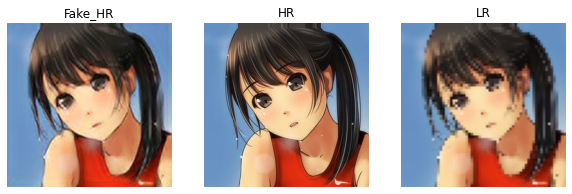

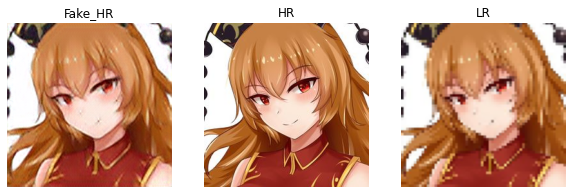

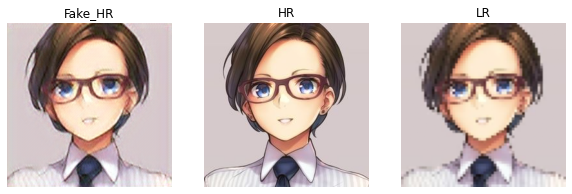

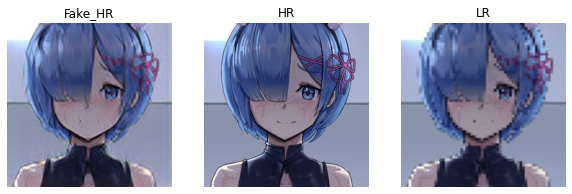

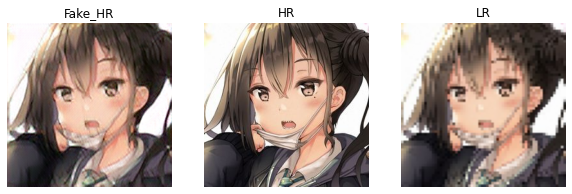

...

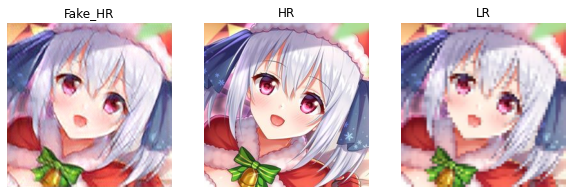

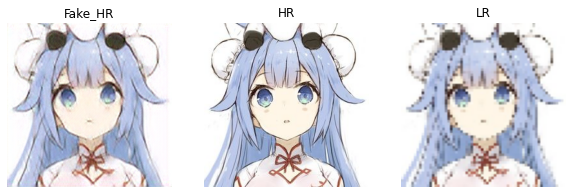

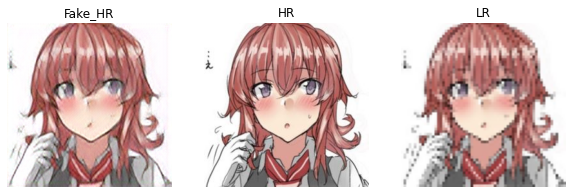

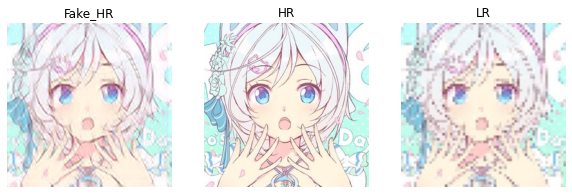

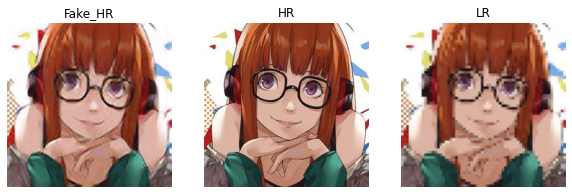

In [ ]:
for idx, (lr, hr) in enumerate(testloader):

    fake_hr = netG(lr)
    vutils.save_image(fake_hr.data, '%s/%03d.png'%(save_img_path, idx),normalize=True)
    fake_hr = plot_img(fake_hr)
    hr = plot_img(hr)
    lr = plot_img(lr)
    plt.figure(figsize=(10,10))
    plt.subplot(1,3,1)
    plt.title('Fake_HR')
    plt.axis('off')
    plt.imshow(fake_hr)
    plt.subplot(1,3,2)
    plt.title('HR')
    plt.axis('off')
    plt.imshow(hr)
    plt.subplot(1,3,3)
    plt.title('LR')
    plt.axis('off')
    plt.imshow(lr)
    plt.savefig(f'/content/gdrive/MyDrive/AnimeFace2/SRGAN64-256/{idx}.png')